### Segmentation Using U-Net

#### Importing the neccessary libraries

In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import VOCSegmentation
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

#### Implementing a functions to display the tensors

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    
    #image_shifted = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

#### Contracting Path

In [ ]:
class ContractingBlock(nn.Module):
    
    def __init__(self, input_channels):
        
        super(ContractingBlock, self).__init__()
        
        self.conv1 = nn.Conv2d(input_channels, input_channels*2, kernel_size=3)
        self.conv2 = nn.Conv2d(input_channels*2, input_channels*2, kernel_size=3)
        self.activation = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2, 2), stride=2)
        
    def forward(self, x):
        
        x = self.conv1(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.activation(x)
        x = self.maxpool(x)
        
        return x
    
    def get_self(self):
        
        return self

In [ ]:
#UNIT TEST
def test_contracting_block(test_samples=100, test_channels=10, test_size=50):
    test_block = ContractingBlock(test_channels)
    test_in = torch.randn(test_samples, test_channels, test_size, test_size)
    test_out_conv1 = test_block.conv1(test_in)
    # Make sure that the first convolution has the right shape
    assert tuple(test_out_conv1.shape) == (test_samples, test_channels * 2, test_size - 2, test_size - 2)
    # Make sure that the right activation is used
    assert torch.all(test_block.activation(test_out_conv1) >= 0)
    assert torch.max(test_block.activation(test_out_conv1)) >= 1
    test_out_conv2 = test_block.conv2(test_out_conv1)
    # Make sure that the second convolution has the right shape
    assert tuple(test_out_conv2.shape) == (test_samples, test_channels * 2, test_size - 4, test_size - 4)
    test_out = test_block(test_in)
    # Make sure that the pooling has the right shape
    assert tuple(test_out.shape) == (test_samples, test_channels * 2, test_size // 2 - 2, test_size // 2 - 2)

test_contracting_block()
test_contracting_block(10, 9, 8)
print("Success!")

Success!


#### Expanding Block

In [ ]:
def crop(image, new_shape):
    
    '''
    Function for cropping an image tensor: Given an image tensor and the new shape,
    crops to the center pixels (assumes that the input's size and the new size are
    even numbers).
    Parameters:
        image: image tensor of shape (batch size, channels, height, width)
        new_shape: a torch.Size object with the shape you want x to have
    '''
    middle_height = image.shape[2] // 2
    middle_width = image.shape[3] // 2
    starting_height = middle_height - new_shape[2] // 2
    final_height = starting_height + new_shape[2]
    starting_width = middle_width - new_shape[3] // 2
    final_width = starting_width + new_shape[3]
    
    cropped_image = image[:, :, starting_height: final_height, starting_width: final_width]
    
    return cropped_image

In [ ]:
#UNIT TEST
def test_expanding_block_crop(test_samples=100, test_channels=10, test_size=100):
    # Make sure that the crop function is the right shape
    skip_con_x = torch.randn(test_samples, test_channels, test_size + 6, test_size + 6)
    x = torch.randn(test_samples, test_channels, test_size, test_size)
    cropped = crop(skip_con_x, x.shape)
    assert tuple(cropped.shape) == (test_samples, test_channels, test_size, test_size)

    # Make sure that the crop function takes the right area
    test_meshgrid = torch.meshgrid([torch.arange(0, test_size), torch.arange(0, test_size)])
    test_meshgrid = test_meshgrid[0] + test_meshgrid[1]
    test_meshgrid = test_meshgrid[None, None, :, :].float()
    cropped = crop(test_meshgrid, torch.Size([1, 1, test_size // 2, test_size // 2]))
    assert cropped.max() == (test_size - 1) * 2 - test_size // 2
    assert cropped.min() == test_size // 2
    assert cropped.mean() == test_size - 1

In [ ]:
class ExpandingBlock(nn.Module):
    
    def __init__(self, input_channels):
        
        super(ExpandingBlock, self).__init__()
        
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.conv1 = nn.Conv2d(input_channels, input_channels // 2, kernel_size=2)
        self.conv2 = nn.Conv2d(input_channels, input_channels // 2, kernel_size=3)
        self.conv3 = nn.Conv2d(input_channels // 2, input_channels // 2, kernel_size=3)
        self.activation = nn.ReLU()
        
    def forward(self, x, skip_con_x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.upsample(x)
        x = self.conv1(x)
        skip_con_x = crop(skip_con_x, x.shape)
        x = torch.cat([x, skip_con_x], axis=1)
        x = self.conv2(x)
        x = self.activation(x)
        x = self.conv3(x)
        x = self.activation(x)
        return x
    
    # Required for grading
    def get_self(self):
        return self

In [ ]:
#UNIT TEST
def test_expanding_block(test_samples=100, test_channels=10, test_size=50):
    test_block = ExpandingBlock(test_channels)
    skip_con_x = torch.randn(test_samples, test_channels // 2, test_size * 2 + 6, test_size * 2 + 6)
    x = torch.randn(test_samples, test_channels, test_size, test_size)
    x = test_block.upsample(x)
    x = test_block.conv1(x)
    # Make sure that the first convolution produces the right shape
    assert tuple(x.shape) == (test_samples, test_channels // 2,  test_size * 2 - 1, test_size * 2 - 1)
    orginal_x = crop(skip_con_x, x.shape)
    x = torch.cat([x, orginal_x], axis=1)
    x = test_block.conv2(x)
    # Make sure that the second convolution produces the right shape
    assert tuple(x.shape) == (test_samples, test_channels // 2,  test_size * 2 - 3, test_size * 2 - 3)
    x = test_block.conv3(x)
    # Make sure that the final convolution produces the right shape
    assert tuple(x.shape) == (test_samples, test_channels // 2,  test_size * 2 - 5, test_size * 2 - 5)
    x = test_block.activation(x)

test_expanding_block_crop()
test_expanding_block()
print("Success!")

Success!


#### Final Layer

In [ ]:
class FeatureMapBlock(nn.Module):
    
    '''
    FeatureMapBlock Class
    The final layer of a UNet - 
    maps each pixel to a pixel with the correct number of output dimensions
    using a 1x1 convolution.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    
    def __init__(self, input_channels, output_channels):
        
        super(FeatureMapBlock, self).__init__()
        
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=1)
        
    def forward(self, x):
        
        x = self.conv(x)
        return x

In [ ]:
# UNIT TEST
assert tuple(FeatureMapBlock(10, 60)(torch.randn(1, 10, 10, 10)).shape) == (1, 60, 10, 10)
print("Success!")

Success!


### U-Net

In [ ]:
class UNet(nn.Module):
    
    '''
    UNet Class
    A series of 4 contracting blocks followed by 4 expanding blocks to 
    transform an input image into the corresponding paired image, with an upfeature
    layer at the start and a downfeature layer at the end
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        
        super(UNet, self).__init__()
        
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        self.contract3 = ContractingBlock(hidden_channels * 4)
        self.contract4 = ContractingBlock(hidden_channels * 8)
        self.expand1 = ExpandingBlock(hidden_channels * 16)
        self.expand2 = ExpandingBlock(hidden_channels * 8)
        self.expand3 = ExpandingBlock(hidden_channels * 4)
        self.expand4 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        
    def forward(self, x):
        '''
        Function for completing a forward pass of UNet: 
        Given an image tensor, passes it through U-Net and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        x4 = self.contract4(x3)
        x5 = self.expand1(x4, x3)
        x6 = self.expand2(x5, x2)
        x7 = self.expand3(x6, x1)
        x8 = self.expand4(x7, x0)
        xn = self.downfeature(x8)
        
        return xn

In [ ]:
#UNIT TEST
test_unet = UNet(1, 3)
assert tuple(test_unet(torch.randn(1, 1, 256, 256)).shape) == (1, 3, 117, 117)
print("Success!")

Success!


### Training

In [ ]:
import torch.nn.functional as F

criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
input_dim = 1
label_dim = 1
display_step = 20
batch_size = 1
lr = 0.0002
initial_shape = 512
target_shape = 373
device = 'cuda'

In [ ]:
from skimage import io
import numpy as np

volumes = torch.Tensor(io.imread('/content/train-volume.tif'))[:, None, :, :] / 255

labels = torch.Tensor(io.imread('/content/train-labels.tif', plugin='pil'))[:, None, :, :] / 255
labels = crop(labels, torch.Size([len(labels), 1, target_shape, target_shape]))
dataset = torch.utils.data.TensorDataset(volumes, labels)

Epoch 0 : Step 0: U-Net Loss: 0.7022881507873535


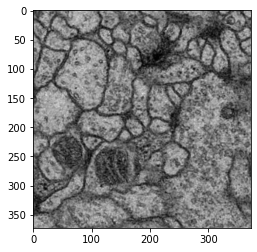

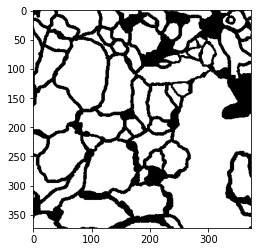

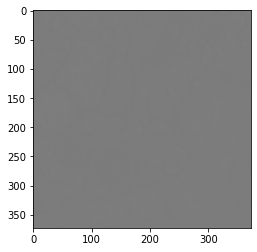

Epoch 0 : Step 20: U-Net Loss: 0.5092730522155762


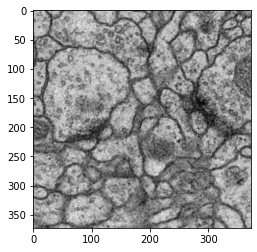

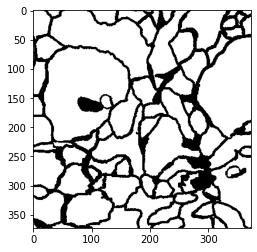

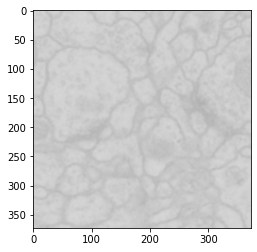

Epoch 1 : Step 40: U-Net Loss: 0.47857341170310974


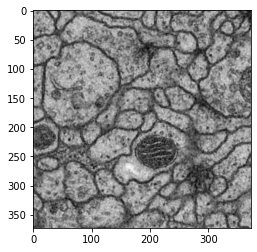

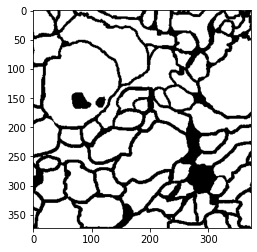

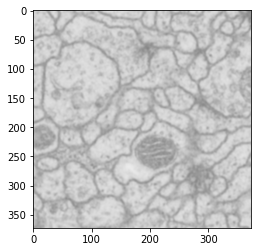

Epoch 2 : Step 60: U-Net Loss: 0.37240687012672424


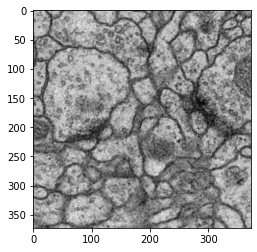

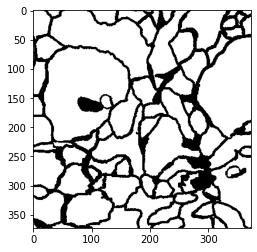

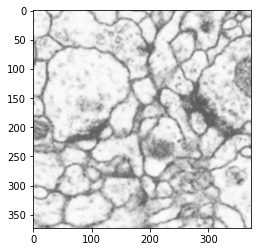

Epoch 2 : Step 80: U-Net Loss: 0.30312296748161316


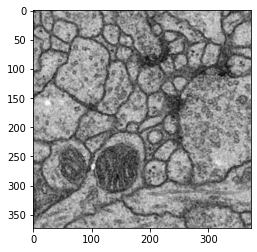

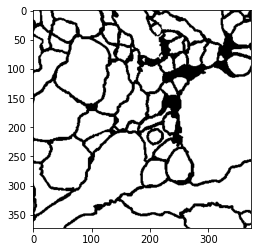

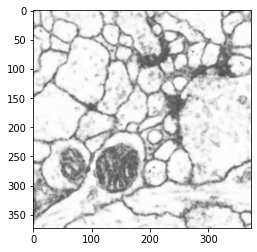

Epoch 3 : Step 100: U-Net Loss: 0.27442389726638794


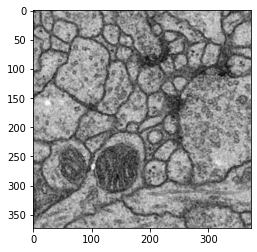

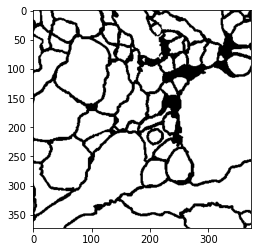

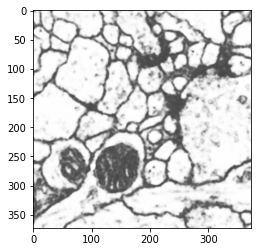

Epoch 4 : Step 120: U-Net Loss: 0.36561763286590576


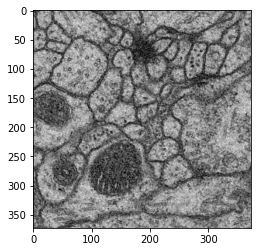

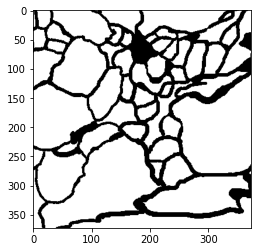

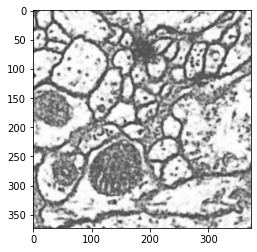

Epoch 4 : Step 140: U-Net Loss: 0.3500451445579529


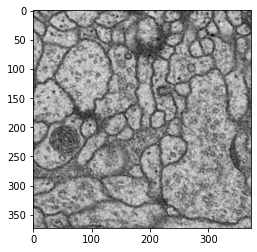

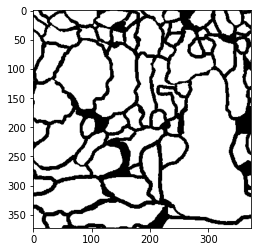

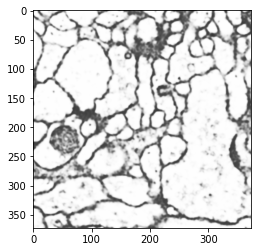

Epoch 5 : Step 160: U-Net Loss: 0.3225169777870178


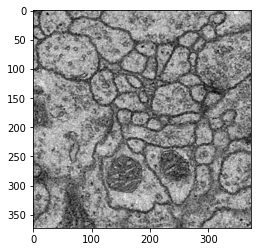

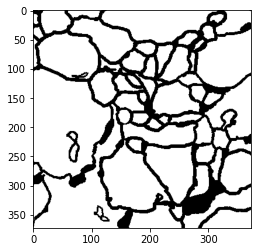

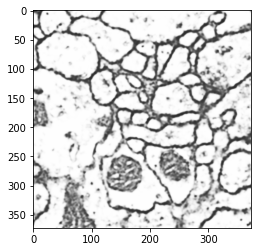

Epoch 6 : Step 180: U-Net Loss: 0.29026904702186584


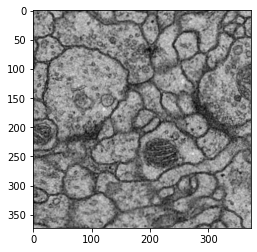

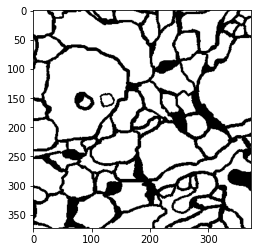

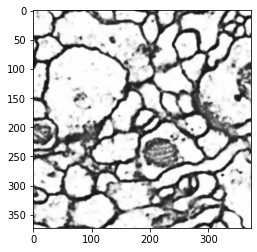

Epoch 6 : Step 200: U-Net Loss: 0.2929269075393677


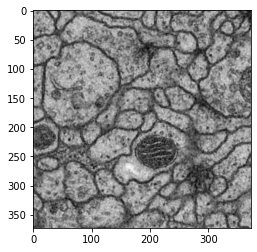

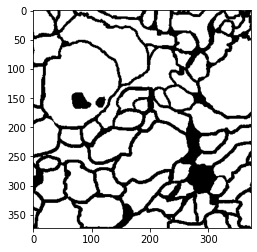

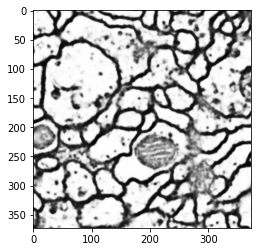

Epoch 7 : Step 220: U-Net Loss: 0.27946609258651733


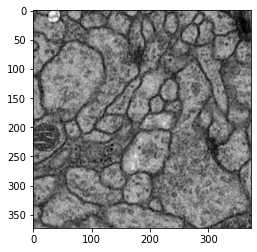

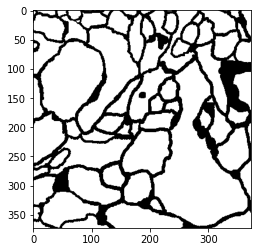

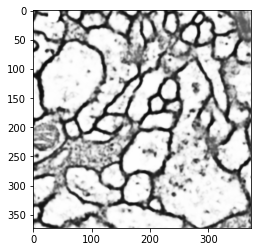

Epoch 8 : Step 240: U-Net Loss: 0.29723119735717773


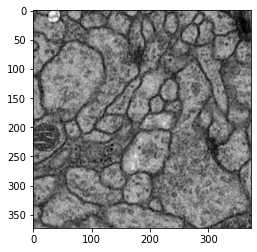

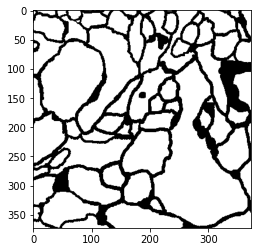

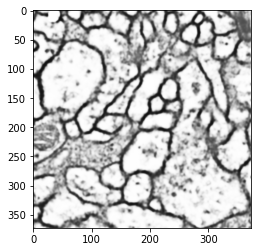

Epoch 8 : Step 260: U-Net Loss: 0.22542650997638702


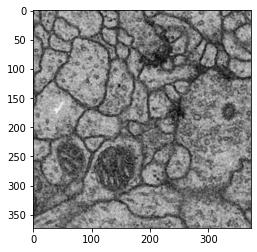

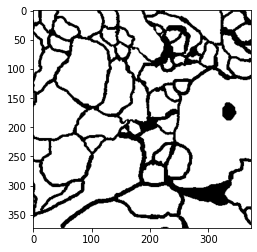

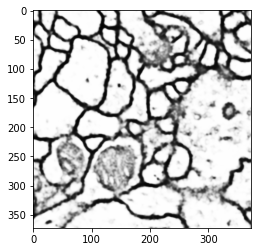

Epoch 9 : Step 280: U-Net Loss: 0.23703429102897644


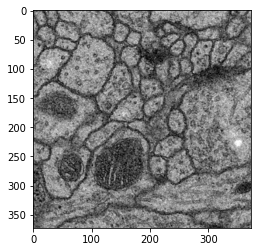

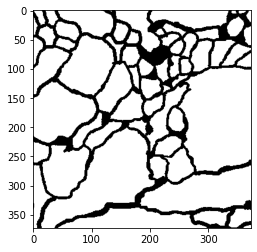

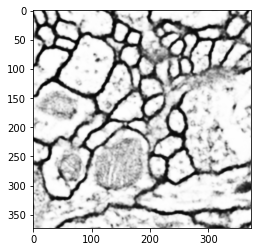

Epoch 10 : Step 300: U-Net Loss: 0.22147993743419647


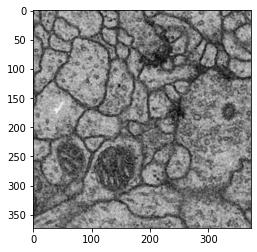

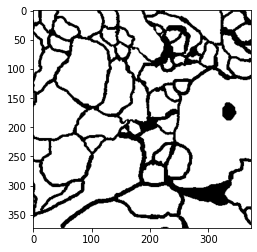

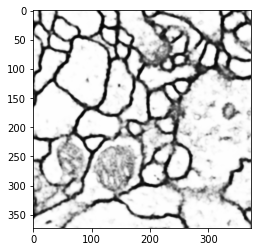

Epoch 10 : Step 320: U-Net Loss: 0.2969176173210144


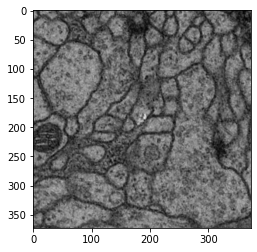

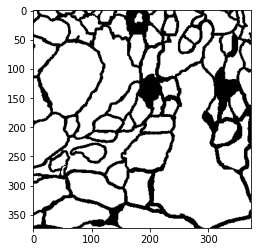

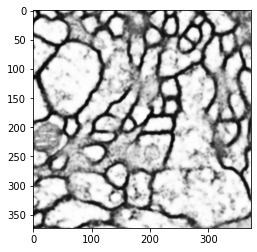

Epoch 11 : Step 340: U-Net Loss: 0.22829973697662354


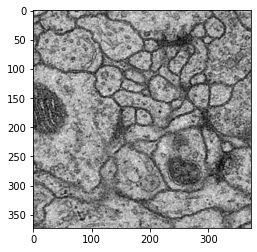

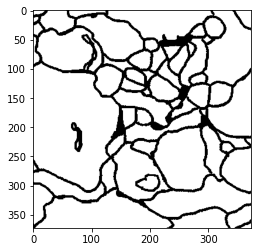

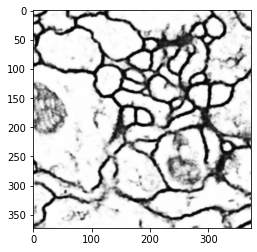

Epoch 12 : Step 360: U-Net Loss: 0.21190685033798218


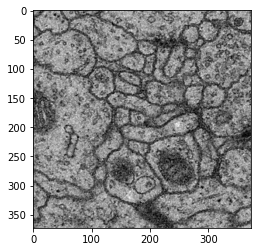

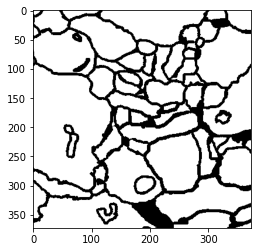

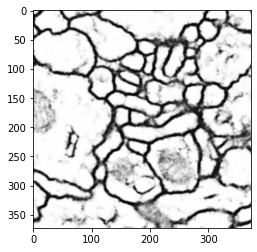

Epoch 12 : Step 380: U-Net Loss: 0.2317415326833725


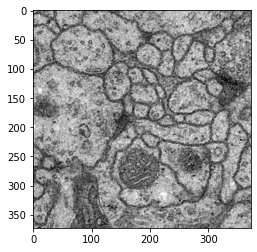

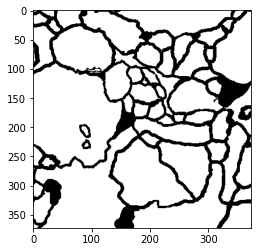

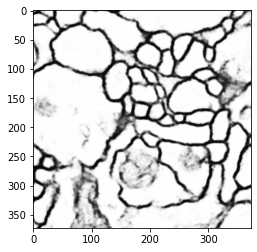

Epoch 13 : Step 400: U-Net Loss: 0.22586101293563843


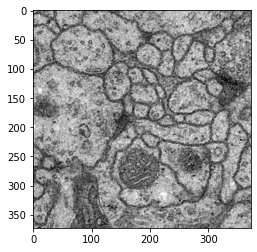

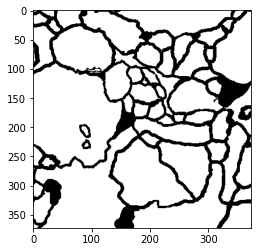

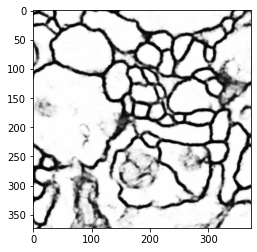

Epoch 14 : Step 420: U-Net Loss: 0.18412373960018158


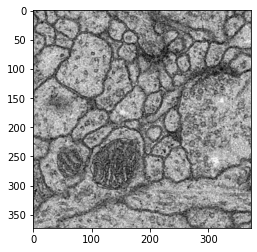

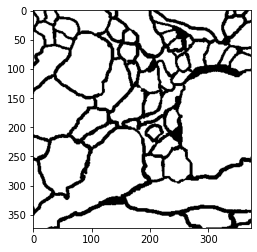

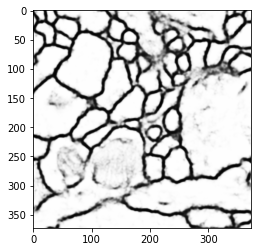

Epoch 14 : Step 440: U-Net Loss: 0.22813457250595093


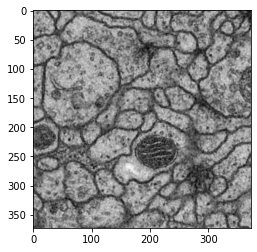

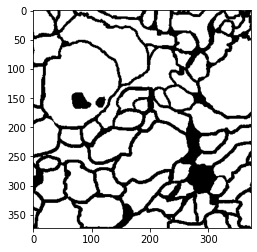

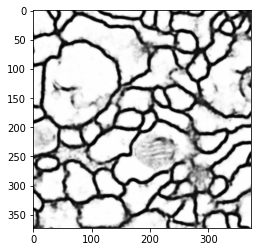

Epoch 15 : Step 460: U-Net Loss: 0.25392892956733704


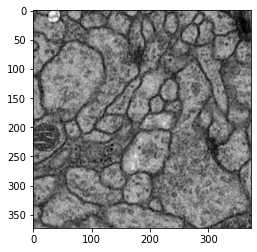

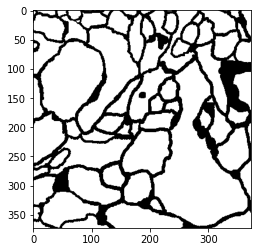

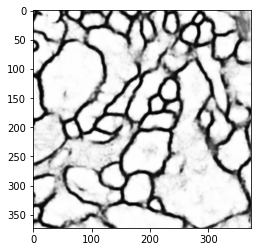

Epoch 16 : Step 480: U-Net Loss: 0.3250511884689331


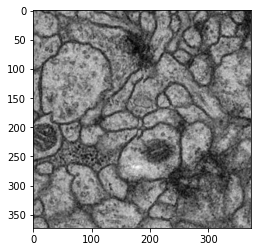

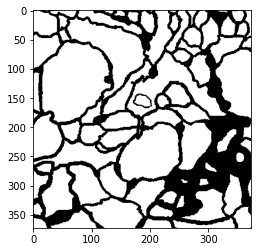

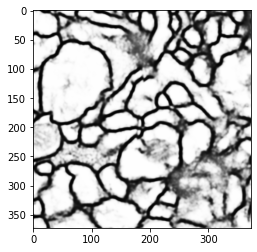

Epoch 16 : Step 500: U-Net Loss: 0.23193542659282684


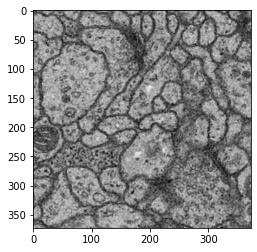

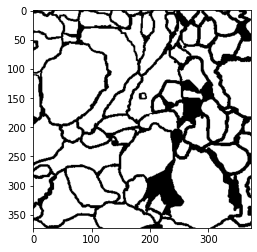

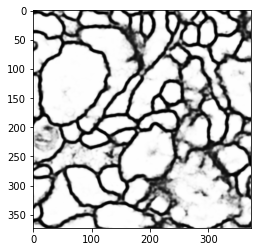

Epoch 17 : Step 520: U-Net Loss: 0.24396833777427673


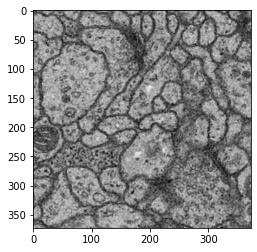

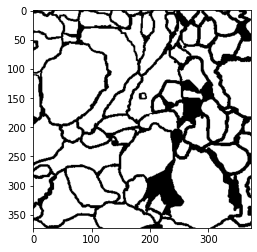

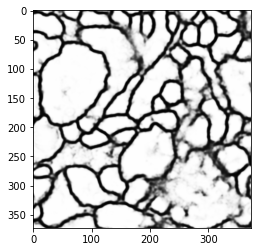

Epoch 18 : Step 540: U-Net Loss: 0.21265403926372528


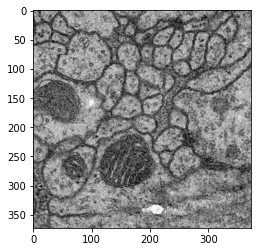

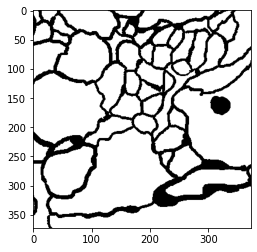

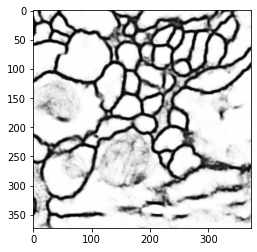

Epoch 18 : Step 560: U-Net Loss: 0.24489791691303253


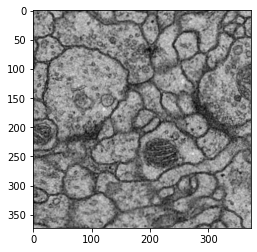

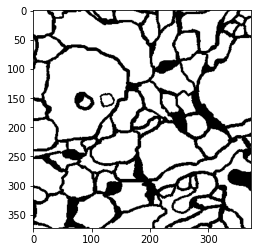

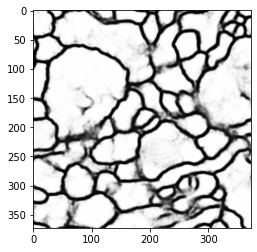

Epoch 19 : Step 580: U-Net Loss: 0.21542179584503174


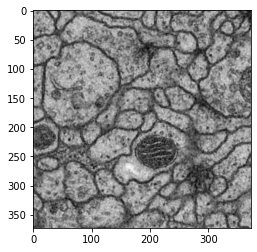

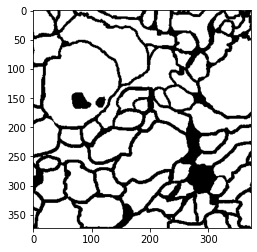

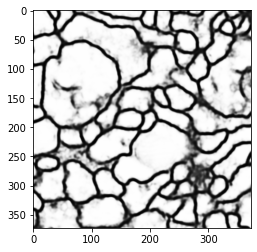

Epoch 20 : Step 600: U-Net Loss: 0.275464802980423


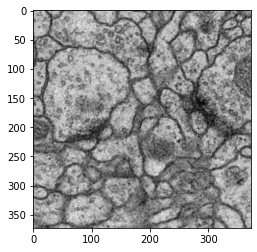

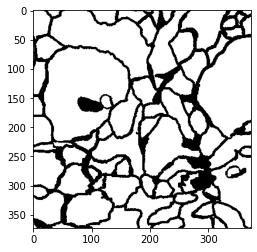

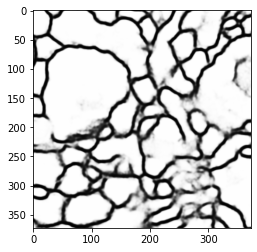

Epoch 20 : Step 620: U-Net Loss: 0.23344361782073975


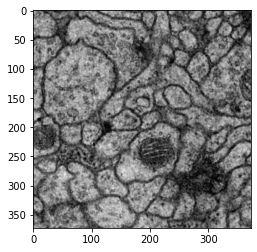

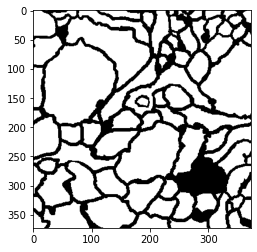

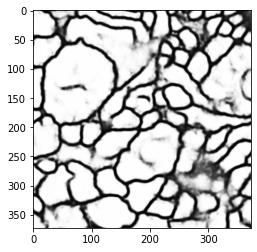

Epoch 21 : Step 640: U-Net Loss: 0.20266488194465637


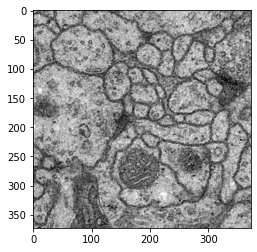

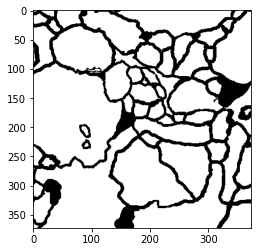

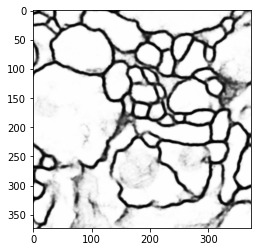

Epoch 22 : Step 660: U-Net Loss: 0.2514216899871826


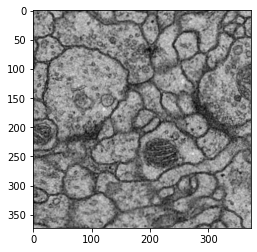

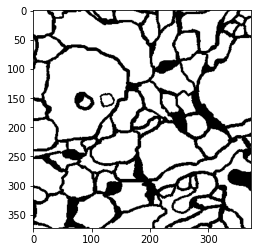

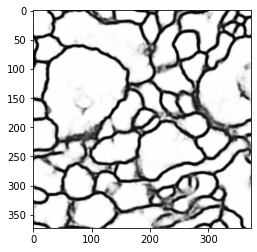

Epoch 22 : Step 680: U-Net Loss: 0.13541170954704285


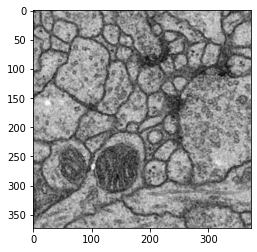

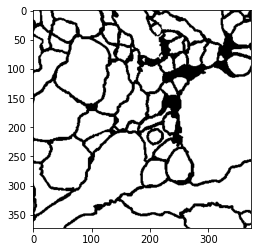

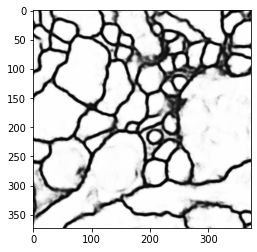

Epoch 23 : Step 700: U-Net Loss: 0.282219260931015


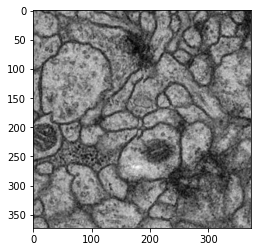

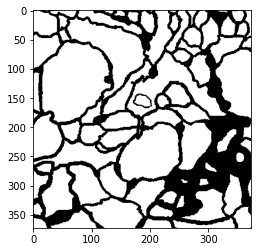

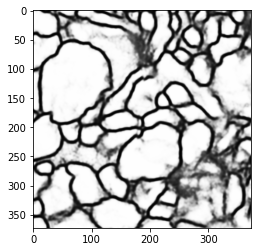

Epoch 24 : Step 720: U-Net Loss: 0.20759902894496918


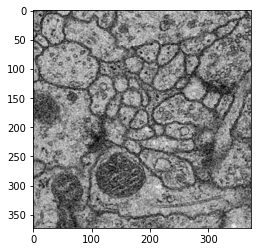

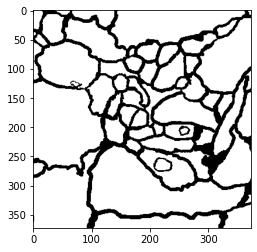

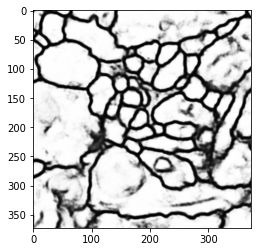

Epoch 24 : Step 740: U-Net Loss: 0.13483285903930664


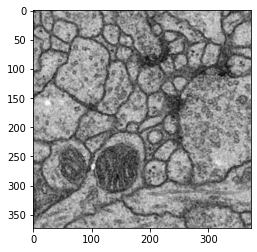

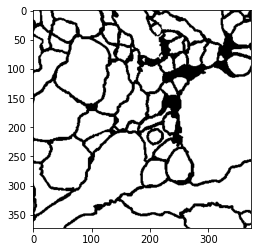

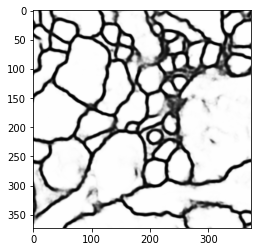

Epoch 25 : Step 760: U-Net Loss: 0.19397349655628204


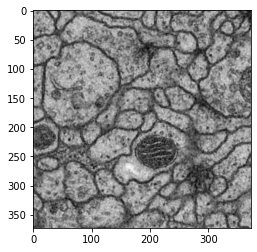

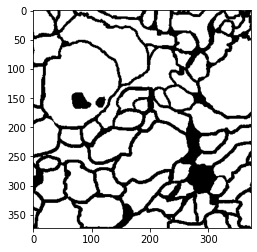

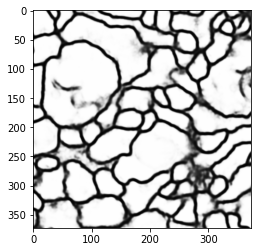

Epoch 26 : Step 780: U-Net Loss: 0.21035943925380707


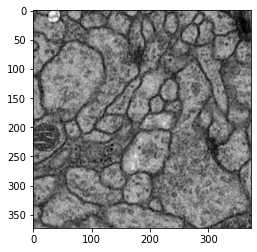

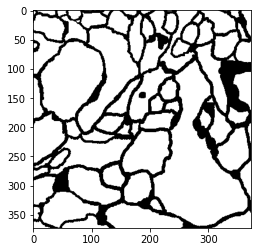

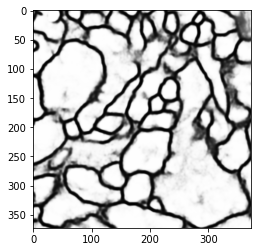

Epoch 26 : Step 800: U-Net Loss: 0.20076945424079895


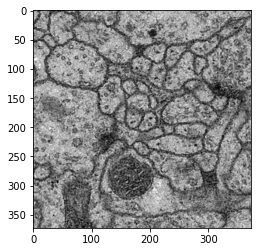

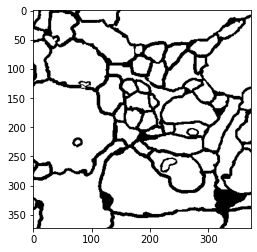

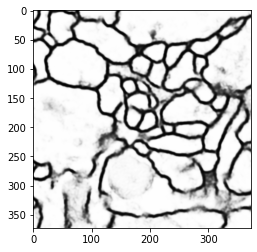

Epoch 27 : Step 820: U-Net Loss: 0.19803547859191895


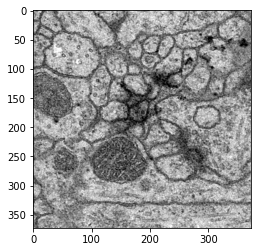

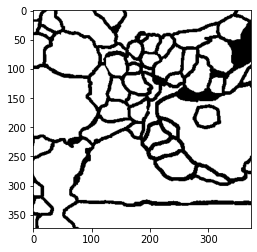

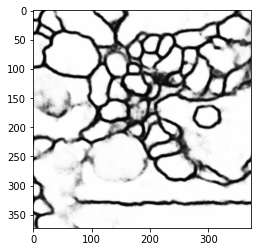

Epoch 28 : Step 840: U-Net Loss: 0.207191601395607


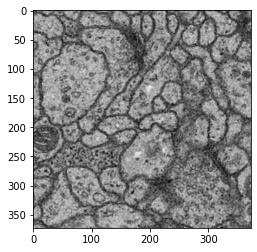

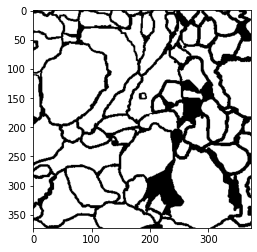

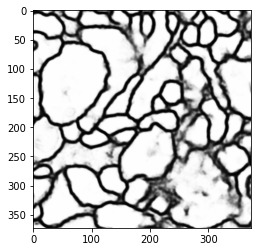

Epoch 28 : Step 860: U-Net Loss: 0.17669962346553802


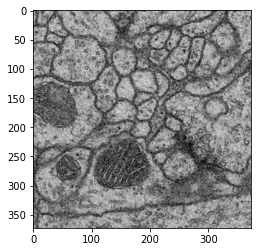

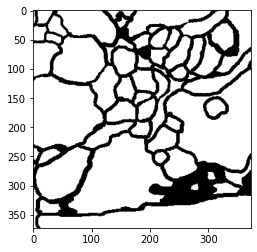

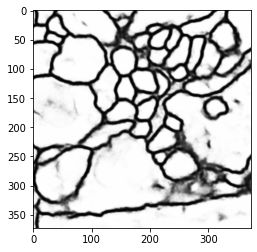

Epoch 29 : Step 880: U-Net Loss: 0.16353857517242432


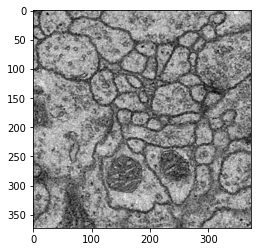

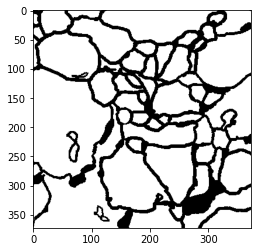

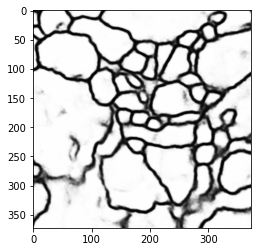

Epoch 30 : Step 900: U-Net Loss: 0.2326531857252121


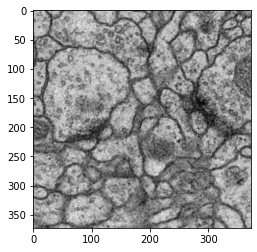

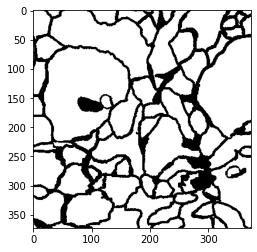

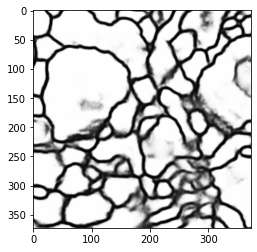

Epoch 30 : Step 920: U-Net Loss: 0.21269556879997253


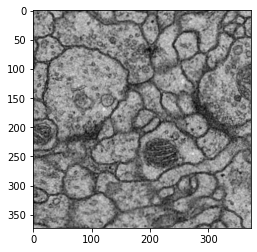

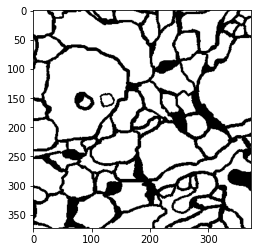

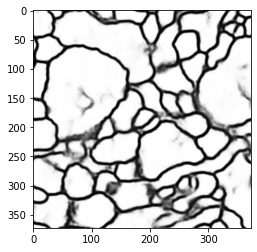

Epoch 31 : Step 940: U-Net Loss: 0.1843302845954895


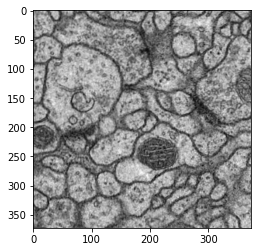

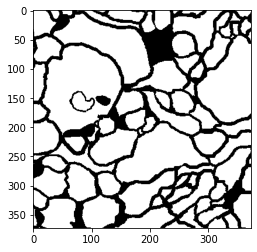

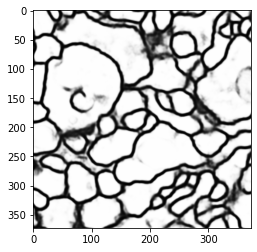

Epoch 32 : Step 960: U-Net Loss: 0.1490558534860611


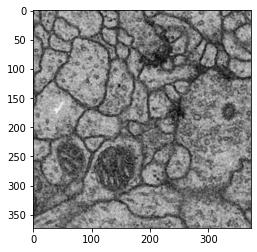

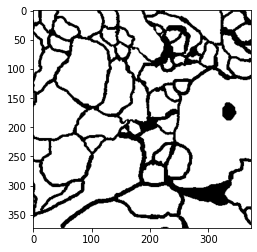

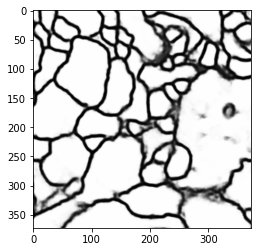

Epoch 32 : Step 980: U-Net Loss: 0.15695910155773163


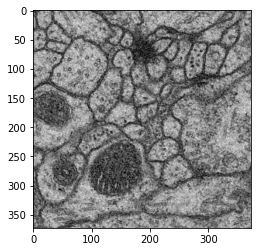

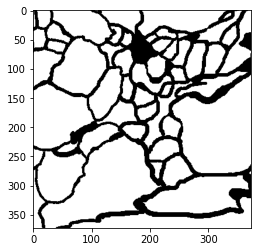

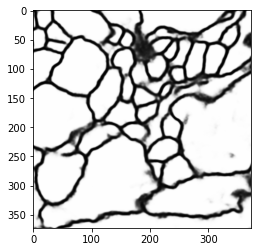

Epoch 33 : Step 1000: U-Net Loss: 0.1382105052471161


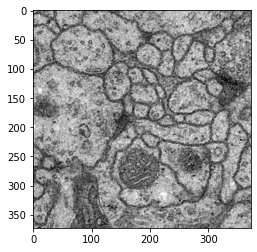

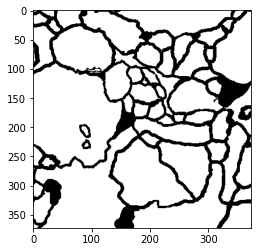

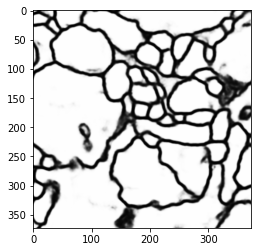

Epoch 34 : Step 1020: U-Net Loss: 0.2157915085554123


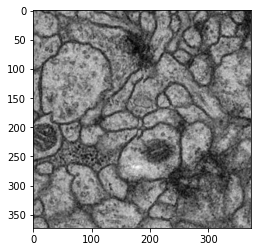

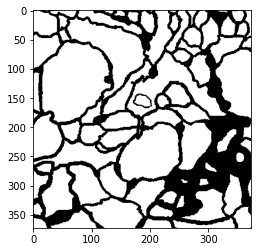

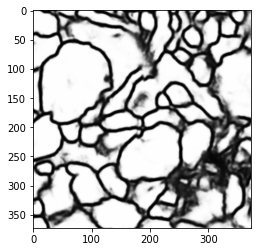

Epoch 34 : Step 1040: U-Net Loss: 0.19248348474502563


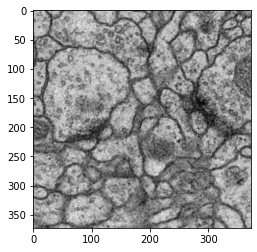

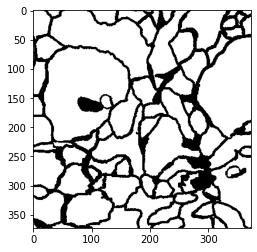

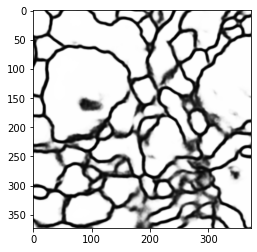

Epoch 35 : Step 1060: U-Net Loss: 0.15030336380004883


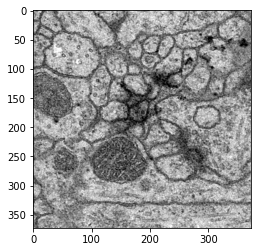

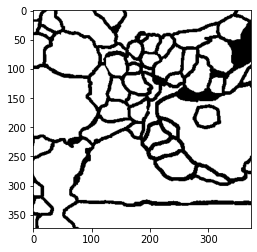

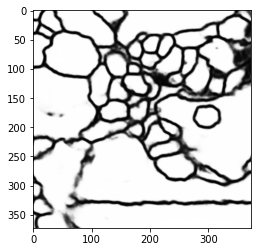

Epoch 36 : Step 1080: U-Net Loss: 0.16056594252586365


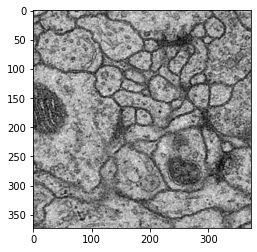

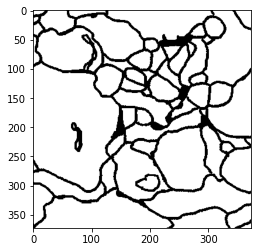

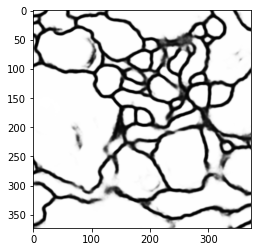

Epoch 36 : Step 1100: U-Net Loss: 0.1412024199962616


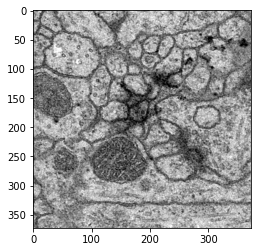

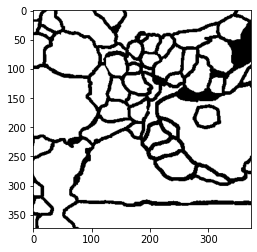

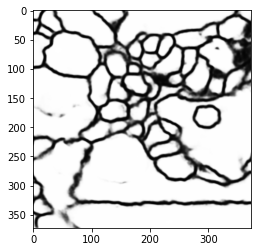

Epoch 37 : Step 1120: U-Net Loss: 0.1365068107843399


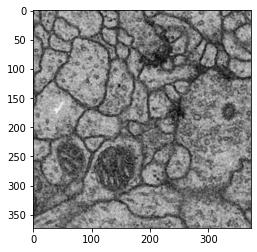

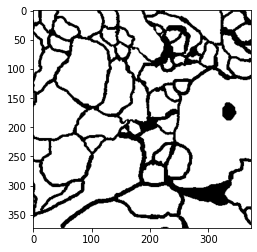

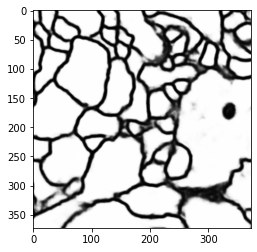

Epoch 38 : Step 1140: U-Net Loss: 0.15243184566497803


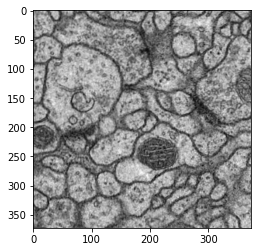

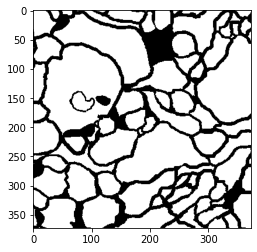

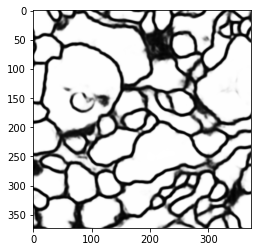

Epoch 38 : Step 1160: U-Net Loss: 0.1363983303308487


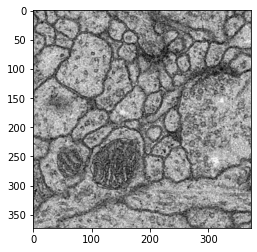

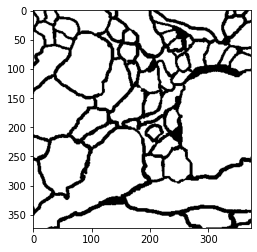

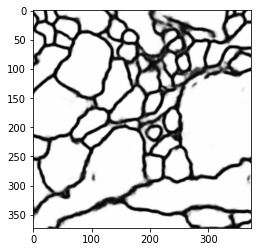

Epoch 39 : Step 1180: U-Net Loss: 0.19243110716342926


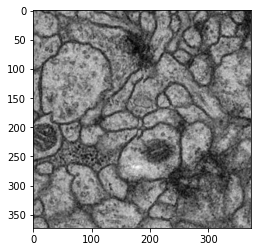

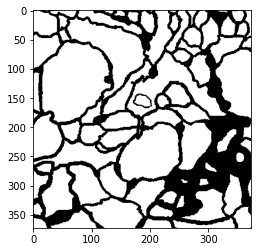

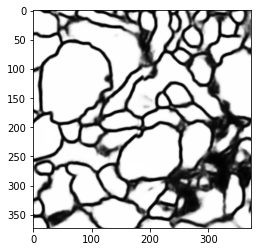

Epoch 40 : Step 1200: U-Net Loss: 0.12220309674739838


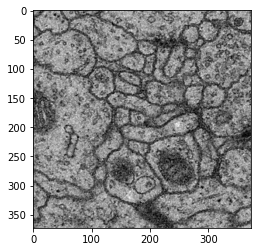

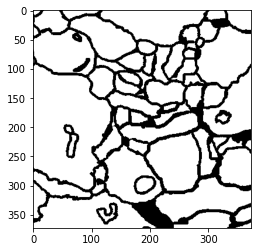

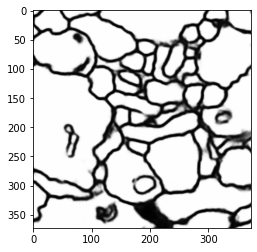

Epoch 40 : Step 1220: U-Net Loss: 0.12848037481307983


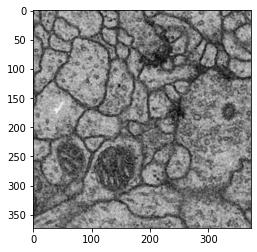

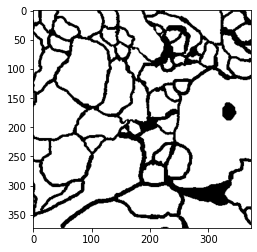

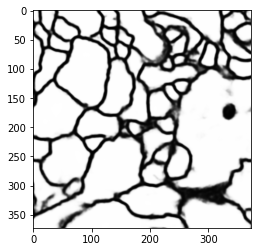

Epoch 41 : Step 1240: U-Net Loss: 0.13757821917533875


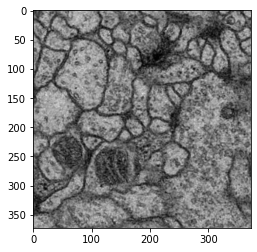

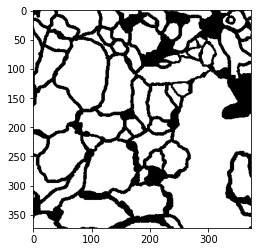

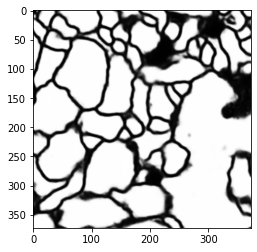

Epoch 42 : Step 1260: U-Net Loss: 0.1198716089129448


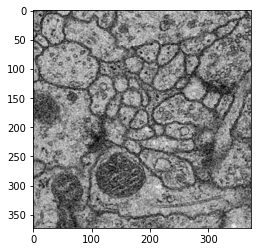

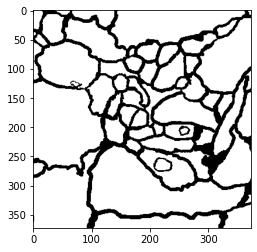

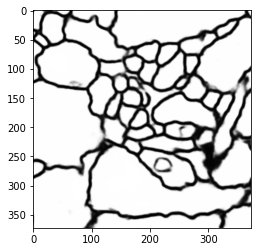

Epoch 42 : Step 1280: U-Net Loss: 0.16743463277816772


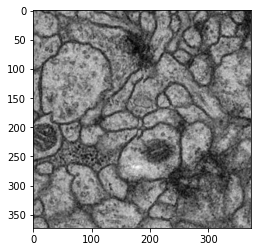

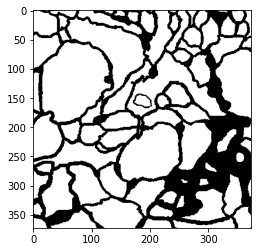

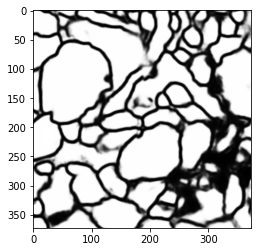

Epoch 43 : Step 1300: U-Net Loss: 0.13470816612243652


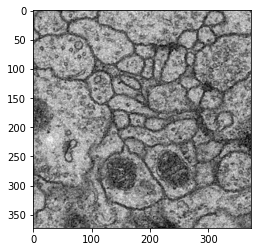

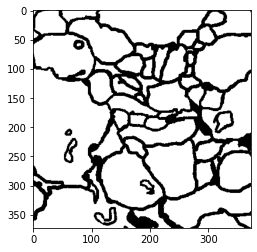

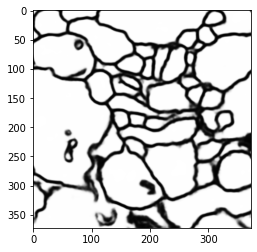

Epoch 44 : Step 1320: U-Net Loss: 0.11970332264900208


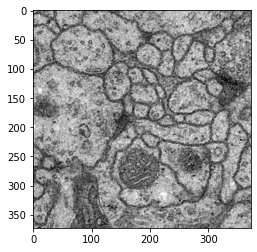

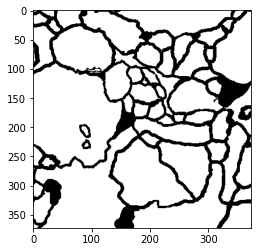

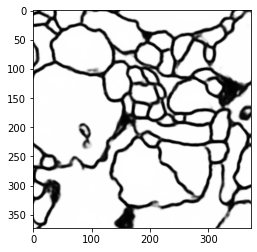

Epoch 44 : Step 1340: U-Net Loss: 0.1138342097401619


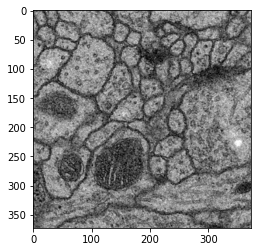

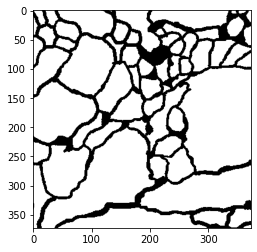

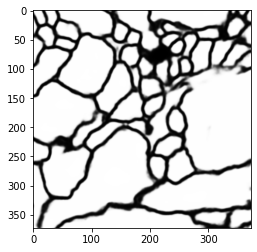

Epoch 45 : Step 1360: U-Net Loss: 0.11320475488901138


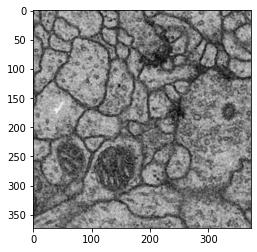

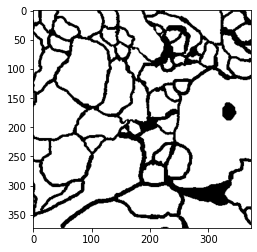

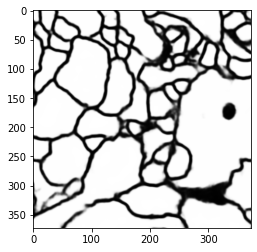

Epoch 46 : Step 1380: U-Net Loss: 0.11774906516075134


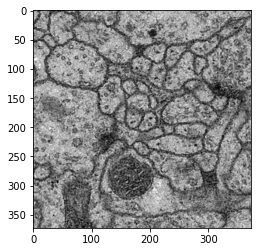

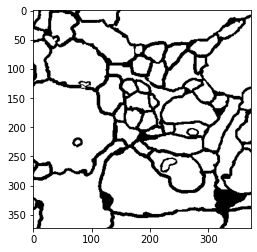

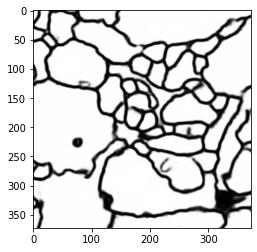

Epoch 46 : Step 1400: U-Net Loss: 0.11995527893304825


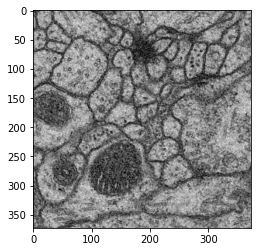

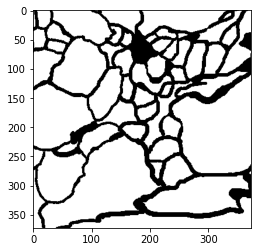

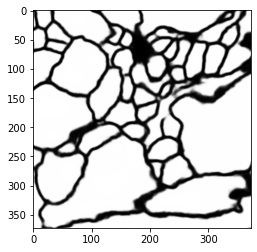

Epoch 47 : Step 1420: U-Net Loss: 0.11730264872312546


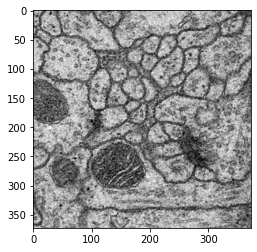

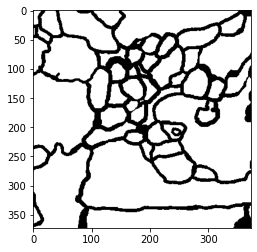

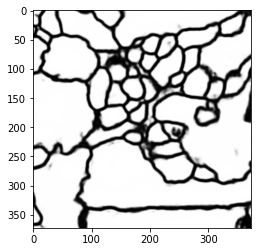

Epoch 48 : Step 1440: U-Net Loss: 0.11586535722017288


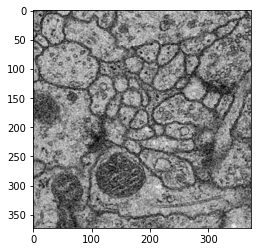

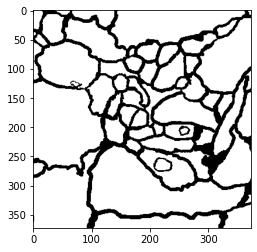

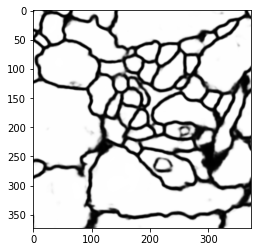

Epoch 48 : Step 1460: U-Net Loss: 0.15777282416820526


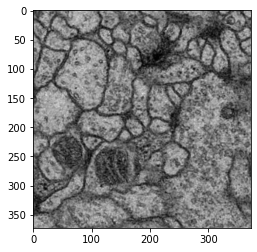

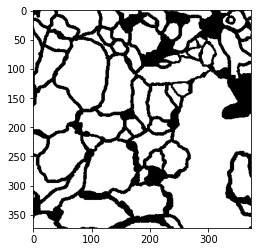

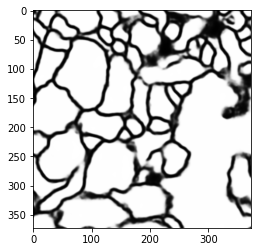

Epoch 49 : Step 1480: U-Net Loss: 0.11686009168624878


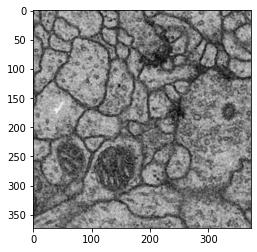

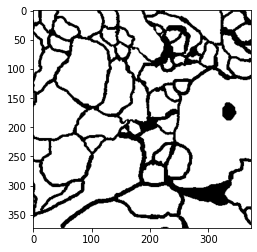

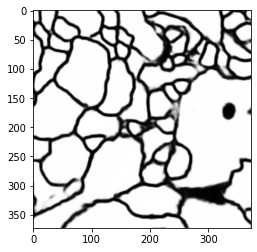

Epoch 50 : Step 1500: U-Net Loss: 0.1436235010623932


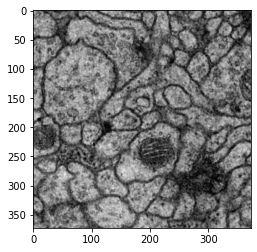

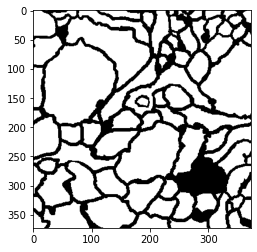

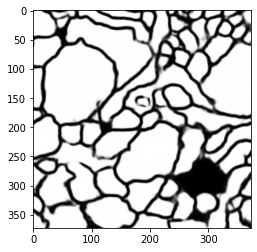

Epoch 50 : Step 1520: U-Net Loss: 0.11273317784070969


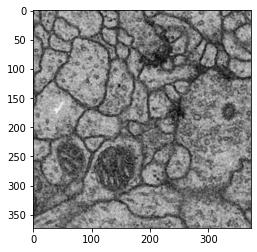

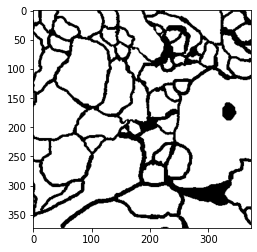

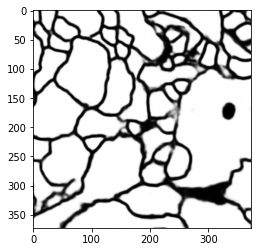

Epoch 51 : Step 1540: U-Net Loss: 0.12143955379724503


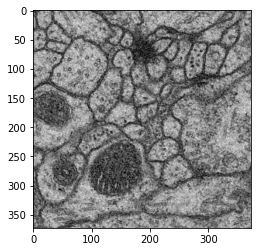

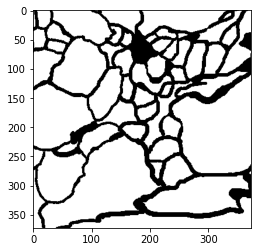

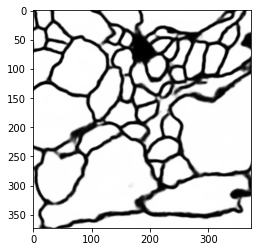

Epoch 52 : Step 1560: U-Net Loss: 0.11718335002660751


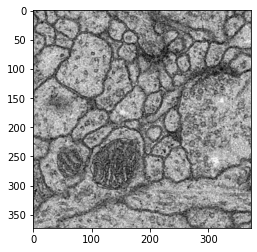

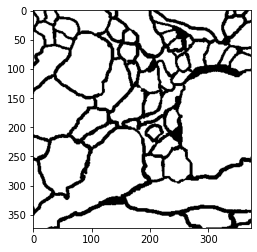

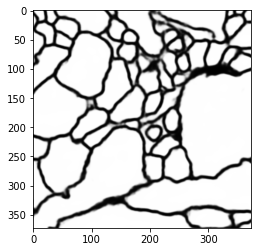

Epoch 52 : Step 1580: U-Net Loss: 0.09943650662899017


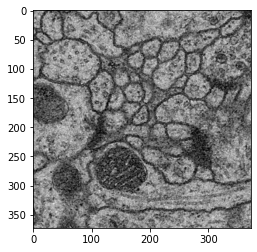

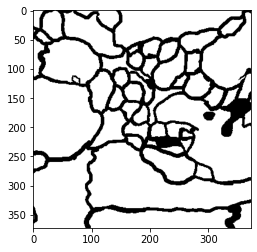

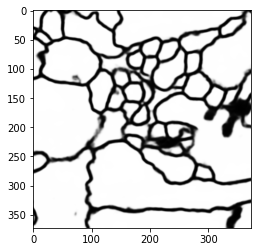

Epoch 53 : Step 1600: U-Net Loss: 0.11130457371473312


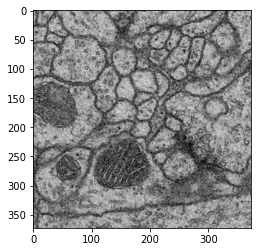

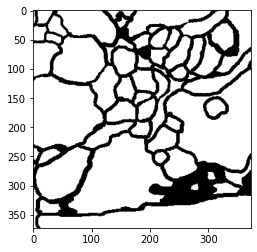

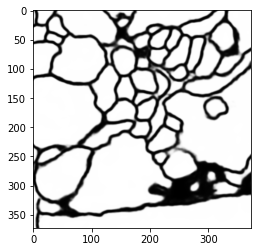

Epoch 54 : Step 1620: U-Net Loss: 0.13011057674884796


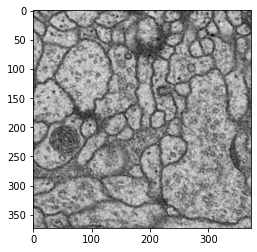

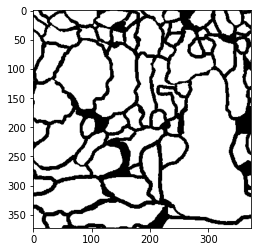

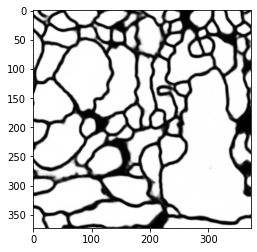

Epoch 54 : Step 1640: U-Net Loss: 0.11691693216562271


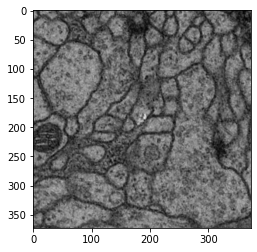

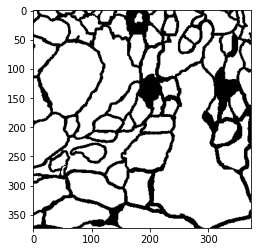

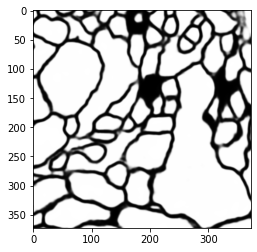

Epoch 55 : Step 1660: U-Net Loss: 0.1257154494524002


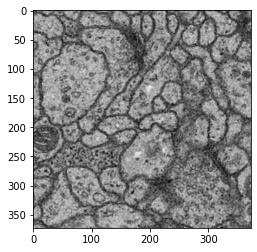

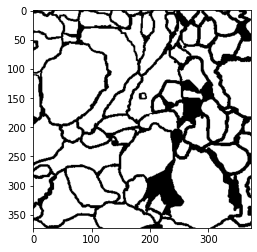

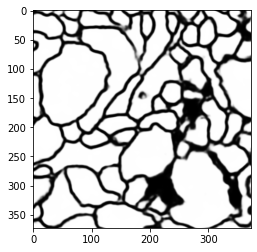

Epoch 56 : Step 1680: U-Net Loss: 0.11563509702682495


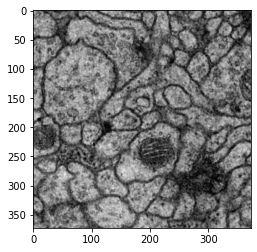

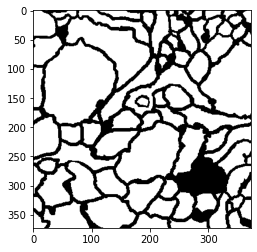

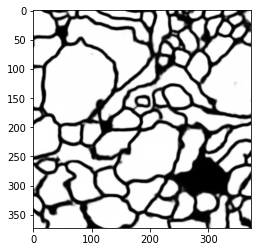

Epoch 56 : Step 1700: U-Net Loss: 0.09581262618303299


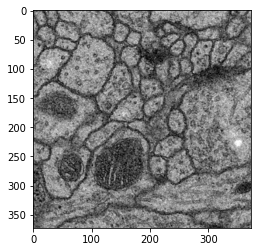

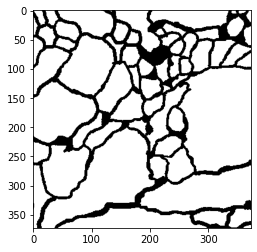

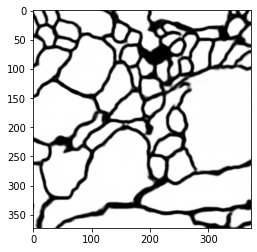

Epoch 57 : Step 1720: U-Net Loss: 0.10258673131465912


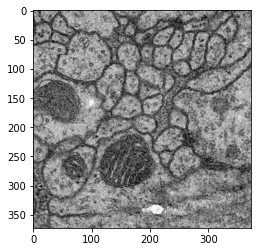

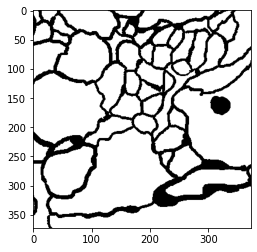

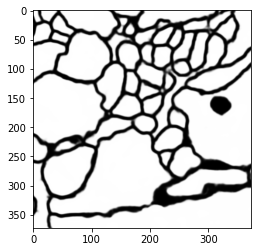

Epoch 58 : Step 1740: U-Net Loss: 0.11467663198709488


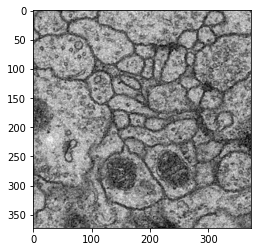

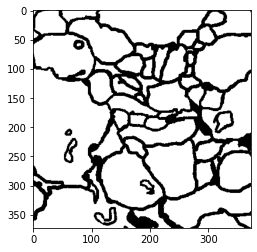

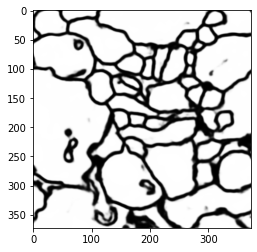

Epoch 58 : Step 1760: U-Net Loss: 0.0982782393693924


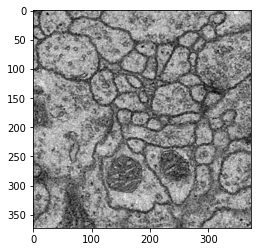

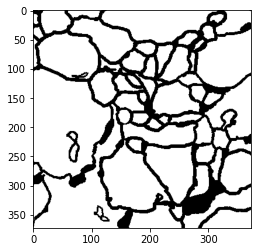

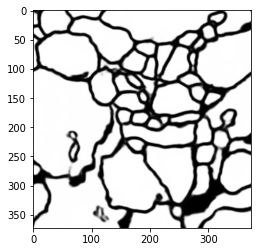

Epoch 59 : Step 1780: U-Net Loss: 0.09649429470300674


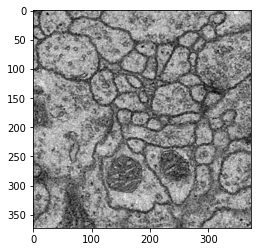

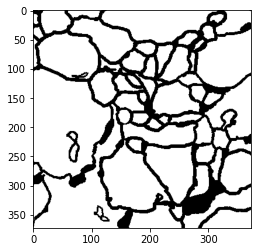

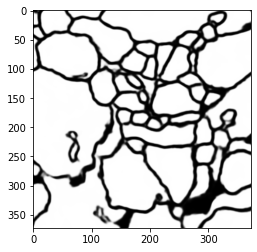

Epoch 60 : Step 1800: U-Net Loss: 0.0910482183098793


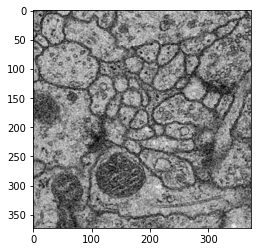

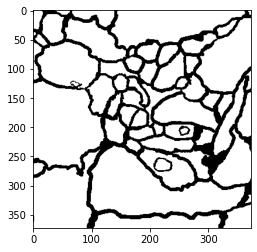

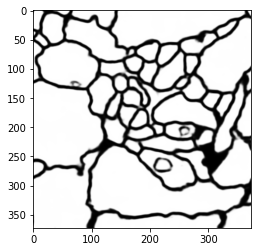

Epoch 60 : Step 1820: U-Net Loss: 0.10704732686281204


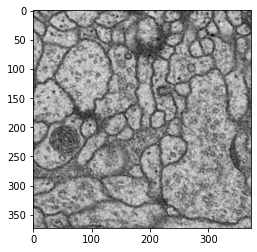

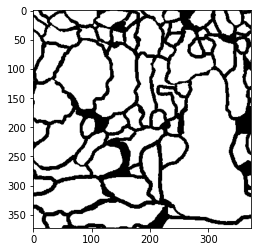

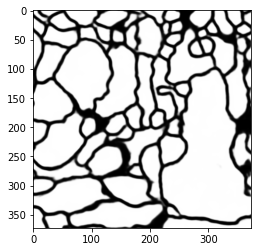

Epoch 61 : Step 1840: U-Net Loss: 0.1127157062292099


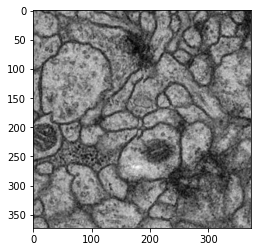

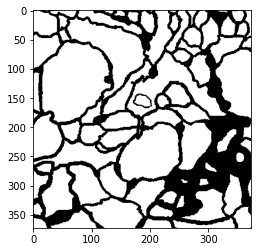

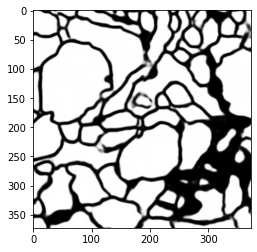

Epoch 62 : Step 1860: U-Net Loss: 0.0891849622130394


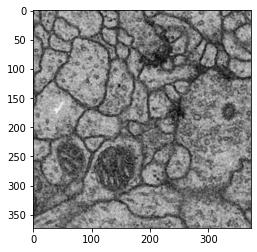

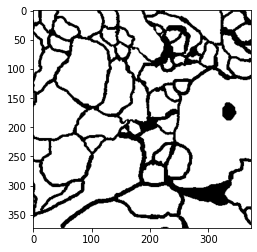

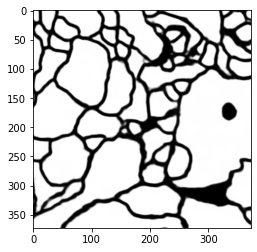

Epoch 62 : Step 1880: U-Net Loss: 0.0964132621884346


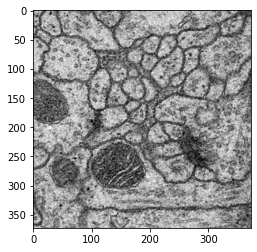

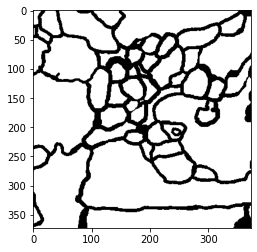

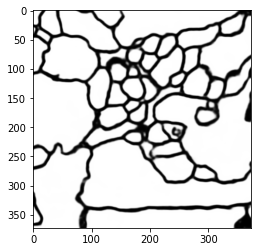

Epoch 63 : Step 1900: U-Net Loss: 0.09025831520557404


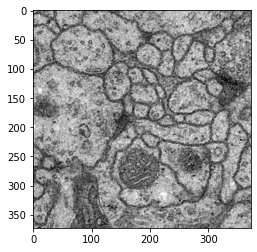

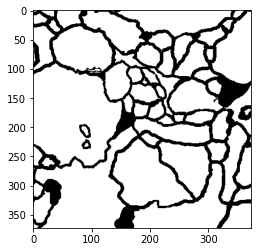

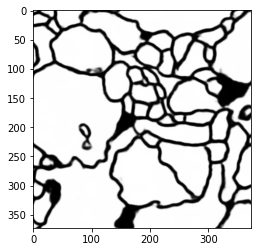

Epoch 64 : Step 1920: U-Net Loss: 0.09721571207046509


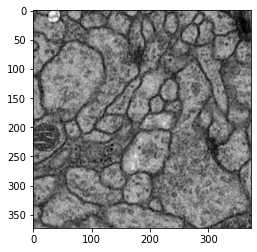

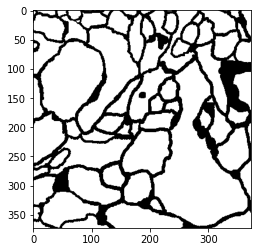

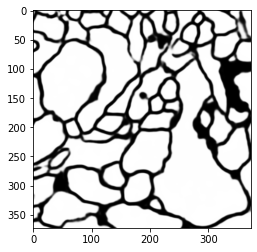

Epoch 64 : Step 1940: U-Net Loss: 0.08439107984304428


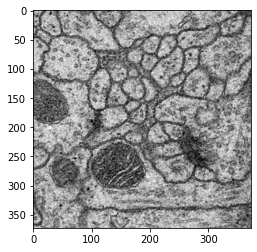

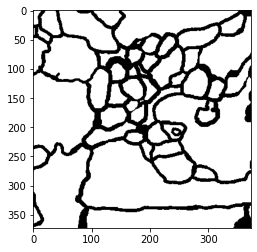

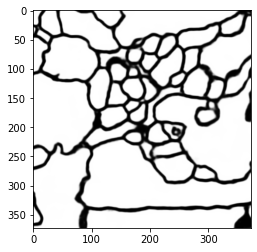

Epoch 65 : Step 1960: U-Net Loss: 0.09590849280357361


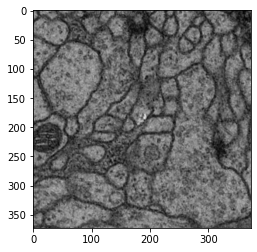

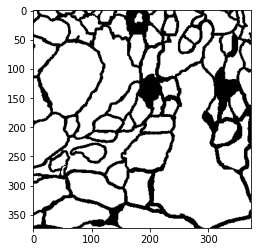

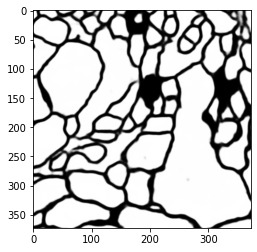

Epoch 66 : Step 1980: U-Net Loss: 0.08635435253381729


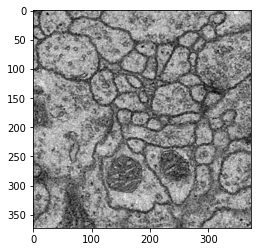

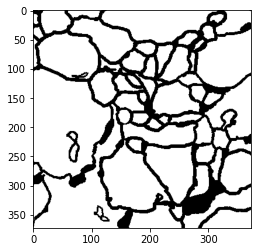

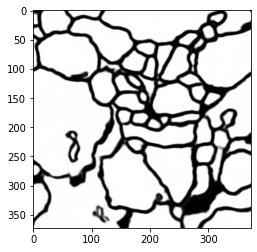

Epoch 66 : Step 2000: U-Net Loss: 0.10061468183994293


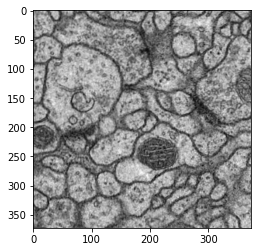

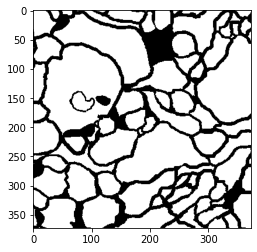

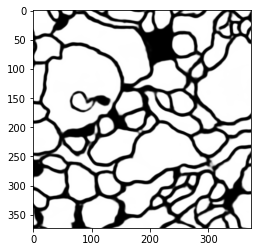

Epoch 67 : Step 2020: U-Net Loss: 0.0730065181851387


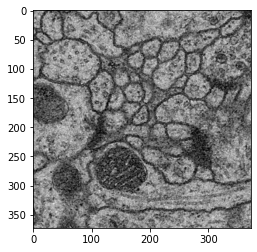

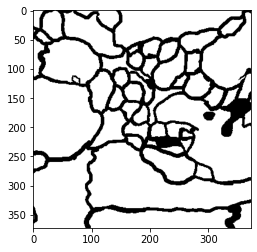

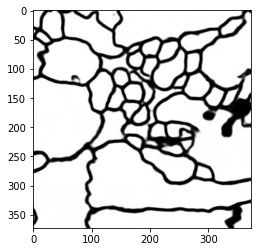

Epoch 68 : Step 2040: U-Net Loss: 0.100942462682724


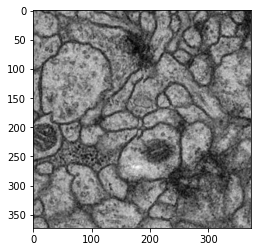

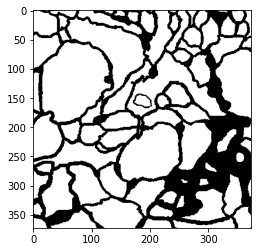

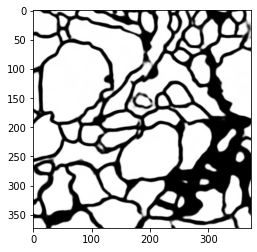

Epoch 68 : Step 2060: U-Net Loss: 0.08484411984682083


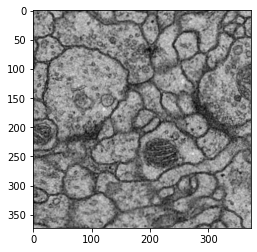

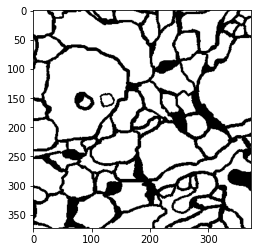

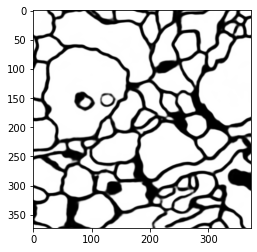

Epoch 69 : Step 2080: U-Net Loss: 0.07200345396995544


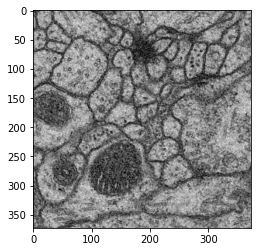

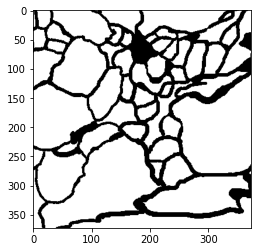

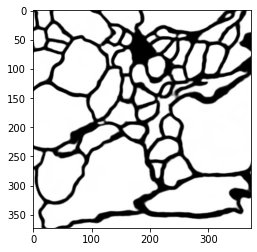

Epoch 70 : Step 2100: U-Net Loss: 0.08647481352090836


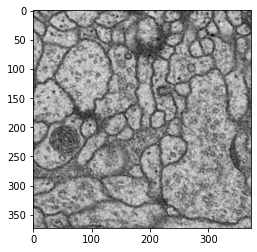

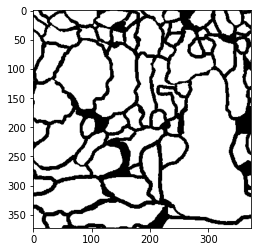

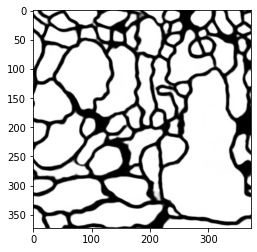

Epoch 70 : Step 2120: U-Net Loss: 0.08697616308927536


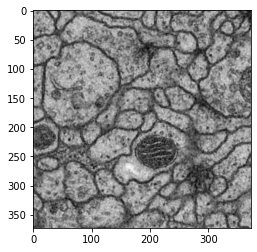

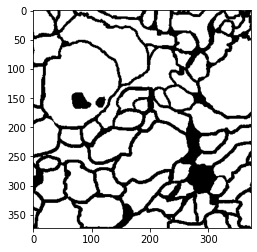

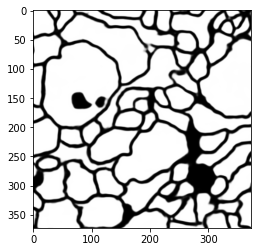

Epoch 71 : Step 2140: U-Net Loss: 0.08093515783548355


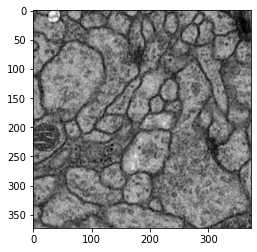

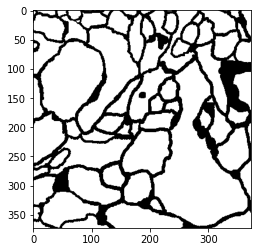

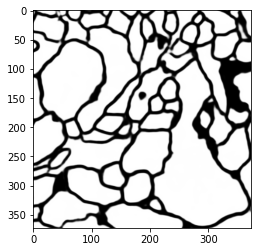

Epoch 72 : Step 2160: U-Net Loss: 0.07763764262199402


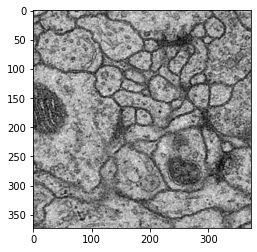

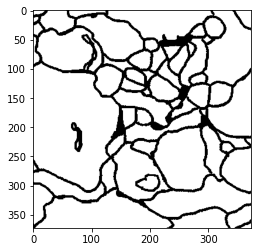

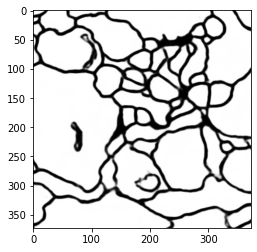

Epoch 72 : Step 2180: U-Net Loss: 0.07786864787340164


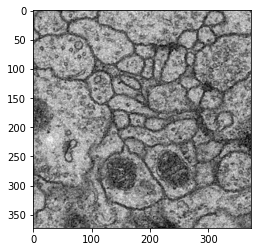

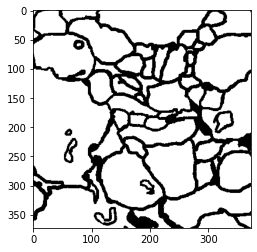

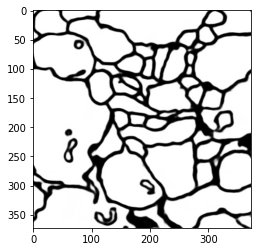

Epoch 73 : Step 2200: U-Net Loss: 0.07777134329080582


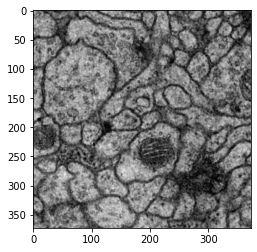

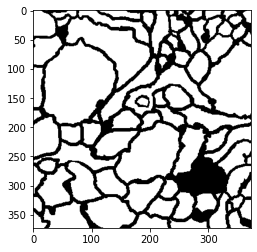

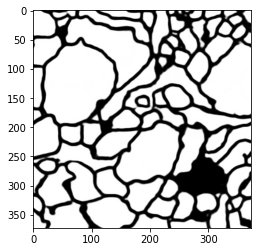

Epoch 74 : Step 2220: U-Net Loss: 0.0814594030380249


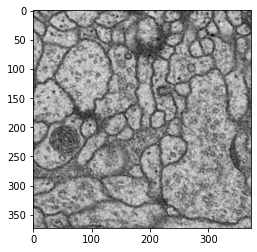

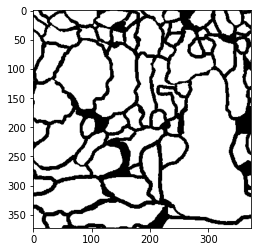

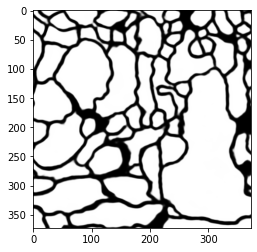

Epoch 74 : Step 2240: U-Net Loss: 0.06975052505731583


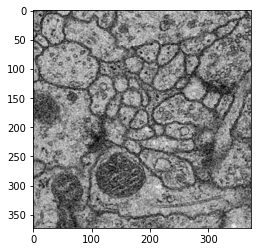

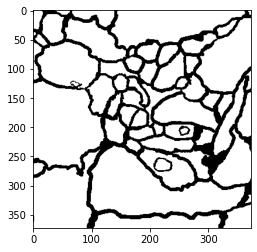

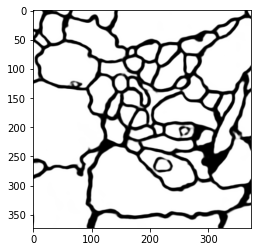

Epoch 75 : Step 2260: U-Net Loss: 0.06914281845092773


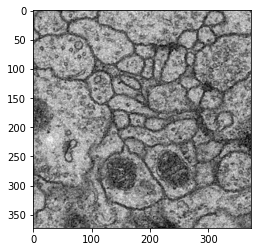

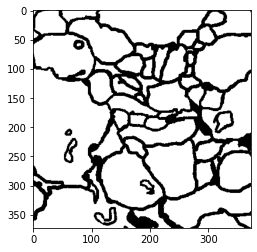

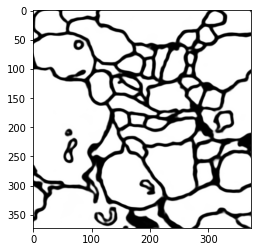

Epoch 76 : Step 2280: U-Net Loss: 0.07357180118560791


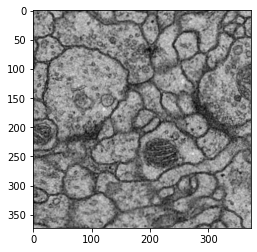

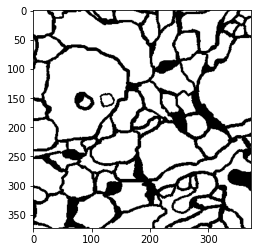

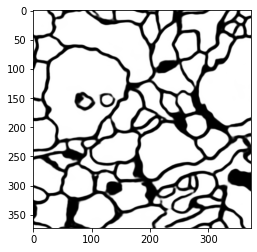

Epoch 76 : Step 2300: U-Net Loss: 0.06358589977025986


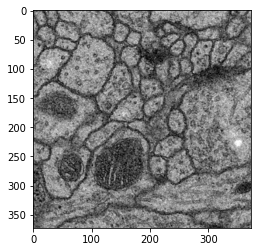

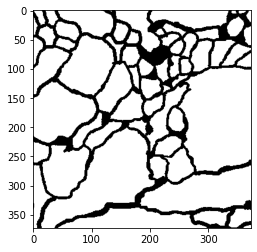

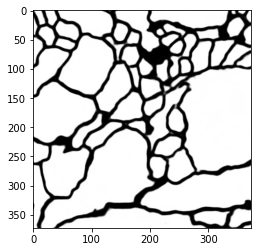

Epoch 77 : Step 2320: U-Net Loss: 0.06825730204582214


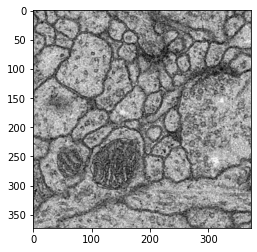

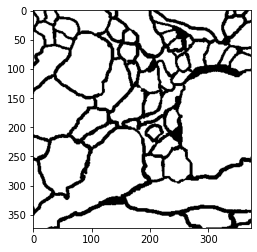

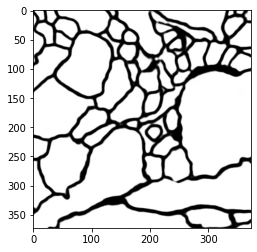

Epoch 78 : Step 2340: U-Net Loss: 0.07165598124265671


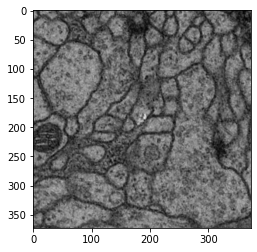

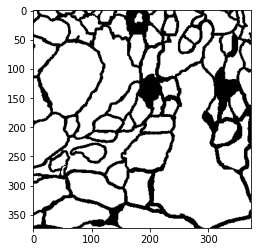

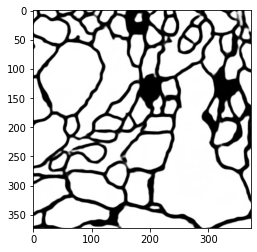

Epoch 78 : Step 2360: U-Net Loss: 0.07999737560749054


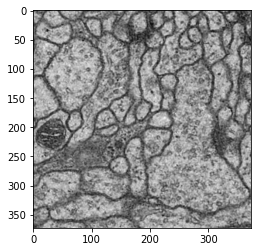

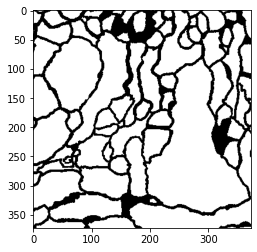

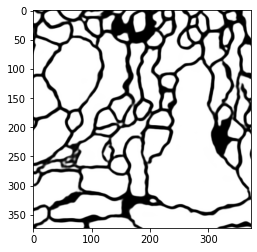

In [ ]:

def train():
    
    dataloader = DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=True
    )
    unet = UNet(input_dim, label_dim).to(device)
    unet_opt = torch.optim.Adam(unet.parameters(), lr=lr)
    cur_step = 0
    
    for epoch in range(n_epochs):
        
        for real, labels in tqdm(dataloader):
            
            cur_batch_size = len(real)
            
            # Flatten the image
            real = real.to(device)
            labels = labels.to(device)
            
            # Update U-Net
            unet_opt.zero_grad()
            pred = unet(real)
            unet_loss = criterion(pred, labels)
            unet_loss.backward() # Accumulates gradient for each parameter
            unet_opt.step()  # Performs a parameter update based on the current gradient

            
            if cur_step % display_step == 0:
                
                print(f"Epoch {epoch} : Step {cur_step}: U-Net Loss: {unet_loss.item()}")
                show_tensor_images(
                    crop(real, torch.Size([len(real), 1, target_shape, target_shape])),
                    size=(input_dim, target_shape, target_shape)
                )
                show_tensor_images(labels, size=(label_dim, target_shape, target_shape))
                show_tensor_images(torch.sigmoid(pred), size=(label_dim, target_shape, target_shape))
            
            cur_step += 1
            

train()